In [1]:
import pandas as pd
import numpy as np
from datetime import datetime,date
from scipy import stats

import squarify
import matplotlib.pyplot as plt
import seaborn as sns


In [2]:
from sklearn.linear_model import LogisticRegression,LinearRegression
from sklearn.metrics import accuracy_score, classification_report, confusion_matrix,mean_squared_error, r2_score
from sklearn.ensemble import RandomForestRegressor,RandomForestClassifier
from sklearn.multioutput import MultiOutputRegressor
from sklearn.model_selection import train_test_split,cross_val_score 
from sklearn.cluster import KMeans
from sklearn.preprocessing import LabelEncoder,MinMaxScaler,KBinsDiscretizer, RobustScaler 

from sklearn.compose import ColumnTransformer
from sklearn.pipeline import Pipeline


import warnings
warnings.filterwarnings('ignore')
from sklearn import svm, datasets


In [3]:
from deep_translator import GoogleTranslator
from wordcloud import WordCloud
import folium
from folium.plugins import HeatMap
from geopy.geocoders import Nominatim

In [4]:
df_orders = pd.read_csv(r"./archiveShopping/olist_orders_dataset.csv")
df_products = pd.read_csv(r"./archiveShopping/olist_products_dataset.csv")
df_sellers = pd.read_csv(r"./archiveShopping/olist_sellers_dataset.csv")
df_category_name = pd.read_csv(r"./archiveShopping/product_category_name_translation.csv")
df_customers = pd.read_csv(r"./archiveShopping/olist_customers_dataset.csv")
df_geolocation = pd.read_csv(r"./archiveShopping/olist_geolocation_dataset.csv")
df_order_item = pd.read_csv(r"./archiveShopping/olist_order_items_dataset.csv")
df_payments = pd.read_csv(r"./archiveShopping/olist_order_payments_dataset.csv")
df_reviews = pd.read_csv(r"./archiveShopping/olist_order_reviews_dataset.csv")

df_orders.head()
df_orders.info()

df_products.head()
df_products.info()

df_sellers.head()
df_sellers.info()

df_category_name.head()
df_category_name.info()

df_customers.head()
df_customers.info()

df_geolocation.head()
df_geolocation.info()

df_order_item.head()
df_order_item.info()

df_payments.head()
df_payments.info()

df_reviews.head()
df_reviews.info()


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 99441 entries, 0 to 99440
Data columns (total 8 columns):
 #   Column                         Non-Null Count  Dtype 
---  ------                         --------------  ----- 
 0   order_id                       99441 non-null  object
 1   customer_id                    99441 non-null  object
 2   order_status                   99441 non-null  object
 3   order_purchase_timestamp       99441 non-null  object
 4   order_approved_at              99281 non-null  object
 5   order_delivered_carrier_date   97658 non-null  object
 6   order_delivered_customer_date  96476 non-null  object
 7   order_estimated_delivery_date  99441 non-null  object
dtypes: object(8)
memory usage: 6.1+ MB
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 32951 entries, 0 to 32950
Data columns (total 9 columns):
 #   Column                      Non-Null Count  Dtype  
---  ------                      --------------  -----  
 0   product_id                  32951 n

In [6]:


print(df_orders.isnull().sum())
print(df_orders.duplicated().sum())

print(df_products.isnull().sum())
print(df_products.duplicated().sum())

print(df_sellers.isnull().sum())
print(df_sellers.duplicated().sum())

print(df_category_name.isnull().sum())
print(df_category_name.duplicated().sum())

print(df_customers.isnull().sum())
print(df_customers.duplicated().sum())

print(df_geolocation.isnull().sum())
print(df_geolocation.duplicated().sum())

print(df_order_item.isnull().sum())
print(df_order_item.duplicated().sum())

print(df_payments.isnull().sum())
print(df_payments.duplicated().sum())

print(df_reviews.isnull().sum())
print(df_reviews.duplicated().sum())


order_id                            0
customer_id                         0
order_status                        0
order_purchase_timestamp            0
order_approved_at                 160
order_delivered_carrier_date     1783
order_delivered_customer_date    2965
order_estimated_delivery_date       0
dtype: int64
0
product_id                      0
product_category_name         610
product_name_lenght           610
product_description_lenght    610
product_photos_qty            610
product_weight_g                2
product_length_cm               2
product_height_cm               2
product_width_cm                2
dtype: int64
0
seller_id                 0
seller_zip_code_prefix    0
seller_city               0
seller_state              0
dtype: int64
0
product_category_name            0
product_category_name_english    0
dtype: int64
0
customer_id                 0
customer_unique_id          0
customer_zip_code_prefix    0
customer_city               0
customer_state              

Null Values in 'df_products'

In [7]:
print(df_products[df_products['product_weight_g'].isnull()])  
 
df_products['product_weight_g'].fillna(df_products.groupby('product_category_name')['product_weight_g'].transform(np.mean),inplace=True) 
df_products['product_length_cm'].fillna(df_products.groupby('product_category_name')['product_length_cm'].transform(np.mean),inplace=True) 
df_products['product_height_cm'].fillna(df_products.groupby('product_category_name')['product_height_cm'].transform(np.mean),inplace=True) 
df_products['product_width_cm'].fillna(df_products.groupby('product_category_name')['product_width_cm'].transform(np.mean),inplace=True) 

df_products.dropna(subset=['product_length_cm'],inplace=True)
df_products.isnull().sum()

for i in ['product_category_name','product_name_lenght','product_description_lenght','product_photos_qty']:
    df_products[i].fillna(df_products[i].mode()[0],inplace=True) 

df_products.isnull().sum()
df_products.info()

                             product_id product_category_name  \
8578   09ff539a621711667c43eba6a3bd8466                 bebes   
18851  5eb564652db742ff8f28759cd8d2652a                   NaN   

       product_name_lenght  product_description_lenght  product_photos_qty  \
8578                  60.0                       865.0                 3.0   
18851                  NaN                         NaN                 NaN   

       product_weight_g  product_length_cm  product_height_cm  \
8578                NaN                NaN                NaN   
18851               NaN                NaN                NaN   

       product_width_cm  
8578                NaN  
18851               NaN  
<class 'pandas.core.frame.DataFrame'>
Int64Index: 32950 entries, 0 to 32950
Data columns (total 9 columns):
 #   Column                      Non-Null Count  Dtype  
---  ------                      --------------  -----  
 0   product_id                  32950 non-null  object 
 1   product_cat

In [8]:
df_orders['order_status'].unique()

array(['delivered', 'invoiced', 'shipped', 'processing', 'unavailable',
       'canceled', 'created', 'approved'], dtype=object)

In [9]:

for i in ['order_purchase_timestamp', 'order_approved_at','order_delivered_carrier_date','order_delivered_customer_date','order_estimated_delivery_date']:
    df_orders[i]= pd.to_datetime(df_orders[i])
print(df_orders.info())


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 99441 entries, 0 to 99440
Data columns (total 8 columns):
 #   Column                         Non-Null Count  Dtype         
---  ------                         --------------  -----         
 0   order_id                       99441 non-null  object        
 1   customer_id                    99441 non-null  object        
 2   order_status                   99441 non-null  object        
 3   order_purchase_timestamp       99441 non-null  datetime64[ns]
 4   order_approved_at              99281 non-null  datetime64[ns]
 5   order_delivered_carrier_date   97658 non-null  datetime64[ns]
 6   order_delivered_customer_date  96476 non-null  datetime64[ns]
 7   order_estimated_delivery_date  99441 non-null  datetime64[ns]
dtypes: datetime64[ns](5), object(3)
memory usage: 6.1+ MB
None


In [10]:
df_order_item['shipping_limit_date']= pd.to_datetime(df_order_item['shipping_limit_date'])

df_orderdata=pd.merge(df_order_item,df_orders, how='left') 
df_orderdata.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 112650 entries, 0 to 112649
Data columns (total 14 columns):
 #   Column                         Non-Null Count   Dtype         
---  ------                         --------------   -----         
 0   order_id                       112650 non-null  object        
 1   order_item_id                  112650 non-null  int64         
 2   product_id                     112650 non-null  object        
 3   seller_id                      112650 non-null  object        
 4   shipping_limit_date            112650 non-null  datetime64[ns]
 5   price                          112650 non-null  float64       
 6   freight_value                  112650 non-null  float64       
 7   customer_id                    112650 non-null  object        
 8   order_status                   112650 non-null  object        
 9   order_purchase_timestamp       112650 non-null  datetime64[ns]
 10  order_approved_at              112635 non-null  datetime64[ns]
 11  

In [11]:
approved = df_orderdata[df_orderdata['order_approved_at'].isnull()]['order_status'][df_orderdata['order_status'].isin( ['delivered', 'invoiced', 'shipped' , 'approved'])].count() 
shipped = df_orderdata[df_orderdata['order_delivered_carrier_date'].isnull()]['order_status'][df_orderdata['order_status'].isin( ['delivered', 'invoiced', 'shipped'])].count()    
delivered = df_orderdata[df_orderdata['order_delivered_customer_date'].isnull()]['order_status'][df_orderdata['order_status'].isin( ['delivered'])].count()   

print( 'for', approved , 'number of approved items order_approved_at is null ')
print('for',shipped, 'number of shipped items order_delivered_carrier_date is null')
print('for',delivered,'number of delivered items order_delivered_customer_date is null' )
df_orderdata.info()

for 15 number of approved items order_approved_at is null 
for 361 number of shipped items order_delivered_carrier_date is null
for 8 number of delivered items order_delivered_customer_date is null
<class 'pandas.core.frame.DataFrame'>
Int64Index: 112650 entries, 0 to 112649
Data columns (total 14 columns):
 #   Column                         Non-Null Count   Dtype         
---  ------                         --------------   -----         
 0   order_id                       112650 non-null  object        
 1   order_item_id                  112650 non-null  int64         
 2   product_id                     112650 non-null  object        
 3   seller_id                      112650 non-null  object        
 4   shipping_limit_date            112650 non-null  datetime64[ns]
 5   price                          112650 non-null  float64       
 6   freight_value                  112650 non-null  float64       
 7   customer_id                    112650 non-null  object        
 8   order_

In [12]:
df_orderdata['diff_date'] = (abs(df_orderdata['order_purchase_timestamp']-df_orderdata['order_approved_at'])/np.timedelta64(1, 'D'))

gp=(df_orderdata.groupby('seller_id')['diff_date'].mean()).fillna(0.0)
print(gp.isnull().sum())

df_orderdata['order_approved_at'] = df_orderdata.apply(lambda x: 
                                    x['order_purchase_timestamp']+ pd.Timedelta(days=int(gp[x['seller_id']]) ) 
                                    if  pd.isnull(x['order_approved_at']) and 
                                    (x['order_status'] in ['delivered', 'invoiced', 'shipped' , 'approved'])
                                    else x['order_approved_at'],axis=1)


df_orderdata['diff_date'] = (abs(df_orderdata['order_purchase_timestamp']-df_orderdata['order_delivered_carrier_date'])/np.timedelta64(1, 'D'))

gp=(df_orderdata.groupby('seller_id')['diff_date'].mean()).fillna(0.0)



df_orderdata['order_delivered_carrier_date'] = df_orderdata.apply(lambda x: 
                                    x['order_purchase_timestamp']+ pd.Timedelta(days=int(gp[x['seller_id']]) ) 
                                    if  pd.isnull(x['order_delivered_carrier_date']) and 
                                    (x['order_status'] in ['delivered', 'invoiced', 'shipped'])
                                    else x['order_delivered_carrier_date'],axis=1)

df_orderdata['diff_date'] = (abs(df_orderdata['order_purchase_timestamp']-df_orderdata['order_delivered_customer_date'])/np.timedelta64(1, 'D'))

gp1=df_orderdata.groupby('seller_id')['diff_date'].mean()
gp=df_orderdata.groupby('seller_id')['diff_date'].mean().fillna(0.0)

df_orderdata['order_delivered_customer_date'] = df_orderdata.apply(lambda x: 
                                    x['order_purchase_timestamp']+ pd.Timedelta(days=int(gp[x['seller_id']]) ) 
                                    if  pd.isnull(x['order_delivered_customer_date']) and 
                                    (x['order_status'] in ['delivered'])
                                    else x['order_delivered_customer_date'],axis=1)

df_orderdata.drop(['diff_date'],axis=1,inplace=True)
df_orderdata['order_delivered_carrier_date'].fillna(pd.to_datetime(0, format='%Y-%m-%d', errors='coerce'),inplace=True)
df_orderdata['order_delivered_customer_date'].fillna(pd.to_datetime(0, format='%Y-%m-%d', errors='coerce'),inplace=True)

df_orderdata.isnull().sum()

0


order_id                         0
order_item_id                    0
product_id                       0
seller_id                        0
shipping_limit_date              0
price                            0
freight_value                    0
customer_id                      0
order_status                     0
order_purchase_timestamp         0
order_approved_at                0
order_delivered_carrier_date     0
order_delivered_customer_date    0
order_estimated_delivery_date    0
dtype: int64

In [13]:
df_sellers_geo=(pd.merge(df_sellers,df_geolocation,left_on=["seller_zip_code_prefix","seller_city","seller_state"], right_on=["geolocation_zip_code_prefix","geolocation_city","geolocation_state"]))[['seller_id','seller_zip_code_prefix','seller_city','seller_state','geolocation_lat','geolocation_lng']]
df_sellers_geo.rename(columns={'geolocation_lat':'seller_geo_lat','geolocation_lng':'seller_geo_lng'},inplace=True)

df_customers_geo=(pd.merge(df_customers,df_geolocation,left_on=["customer_zip_code_prefix","customer_city","customer_state"], right_on=["geolocation_zip_code_prefix","geolocation_city","geolocation_state"]))[['customer_id','customer_unique_id','customer_zip_code_prefix','customer_city','customer_state','geolocation_lat','geolocation_lng']]
df_customers_geo.rename(columns={'geolocation_lat':'customer_geo_lat','geolocation_lng':'customer_geo_lng'},inplace=True)

df=pd.merge(pd.merge(df_orderdata,df_products),df_category_name)



In [14]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 112609 entries, 0 to 112608
Data columns (total 23 columns):
 #   Column                         Non-Null Count   Dtype         
---  ------                         --------------   -----         
 0   order_id                       112609 non-null  object        
 1   order_item_id                  112609 non-null  int64         
 2   product_id                     112609 non-null  object        
 3   seller_id                      112609 non-null  object        
 4   shipping_limit_date            112609 non-null  datetime64[ns]
 5   price                          112609 non-null  float64       
 6   freight_value                  112609 non-null  float64       
 7   customer_id                    112609 non-null  object        
 8   order_status                   112609 non-null  object        
 9   order_purchase_timestamp       112609 non-null  datetime64[ns]
 10  order_approved_at              112609 non-null  datetime64[ns]
 11  

Price of products 

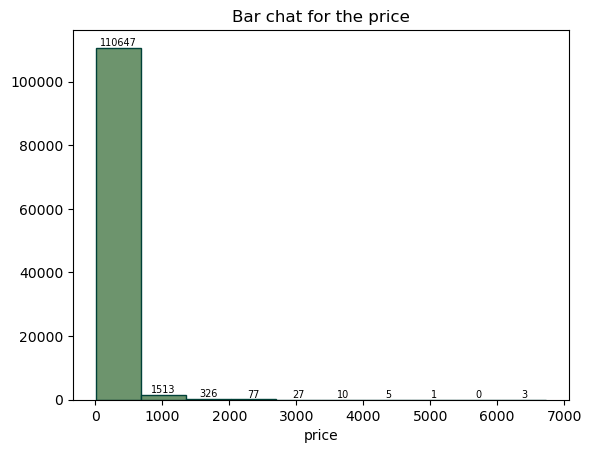

In [15]:
k=plt.hist(x=df['price'],color='#6d946d',edgecolor='#004138')
plt.xlabel('price')
plt.title('Bar chat for the price')
plt.bar_label(k[2], fontsize=7, color='black')
plt.show()

Number of products purchasing by customer

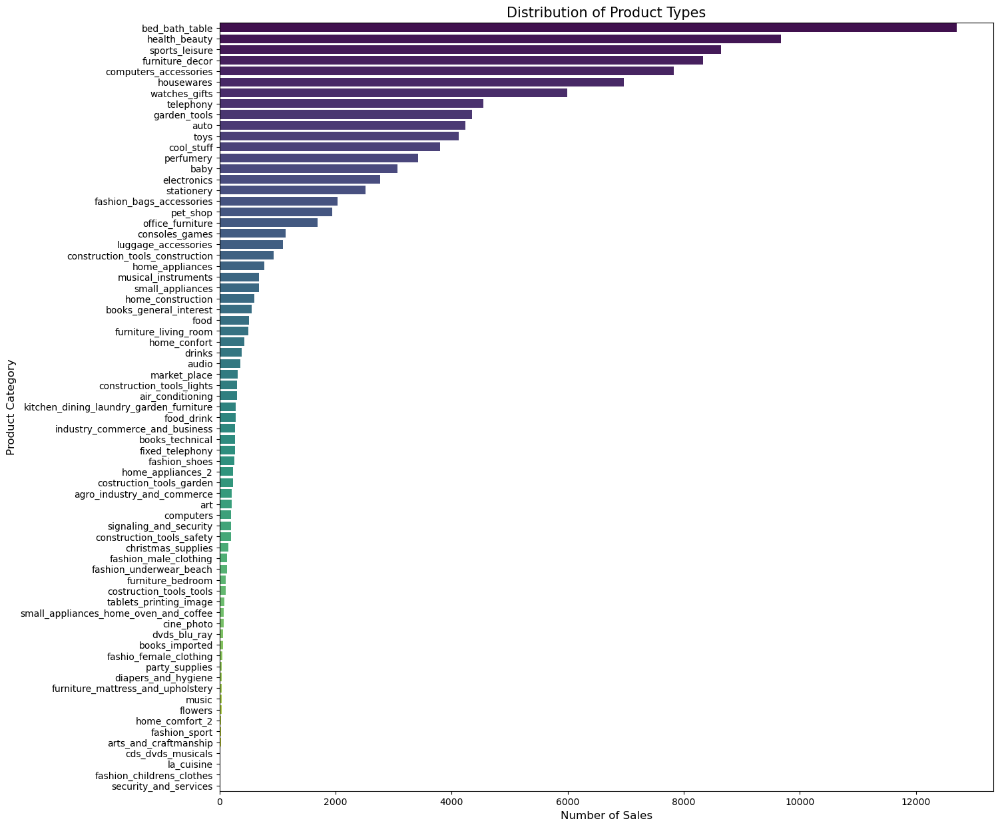

In [16]:

category_counts = df['product_category_name_english'].value_counts()

plt.figure(figsize=(15,15))
sns.barplot(y=category_counts.index, x=category_counts.values, palette="viridis")
plt.xlabel('Number of Sales', fontsize=12)
plt.ylabel('Product Category', fontsize=12)
plt.title('Distribution of Product Types', fontsize=15)
plt.show()


<Axes: >

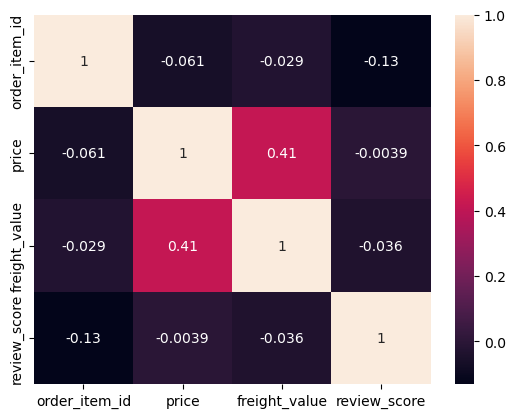

In [17]:
sns.heatmap(pd.merge(df_order_item,df_reviews).corr(), annot= True)

In [18]:
z=pd.merge(df_order_item,df_reviews).groupby('product_id')[['price','review_score']].mean()
z['count']=pd.merge(df_order_item,df_reviews).groupby('product_id')[['price']].count()
z.describe()


,price,review_score,count
count,32789.000000,32789.000000,32789.000000
mean,145.172391,4.047807,3.427125
std,244.523242,1.213910,10.628914
min,0.850000,1.000000,1.000000
25%,39.900000,3.611111,1.000000
50%,79.000000,4.500000,1.000000
75%,154.935000,5.000000,3.000000
max,6735.000000,5.000000,524.000000


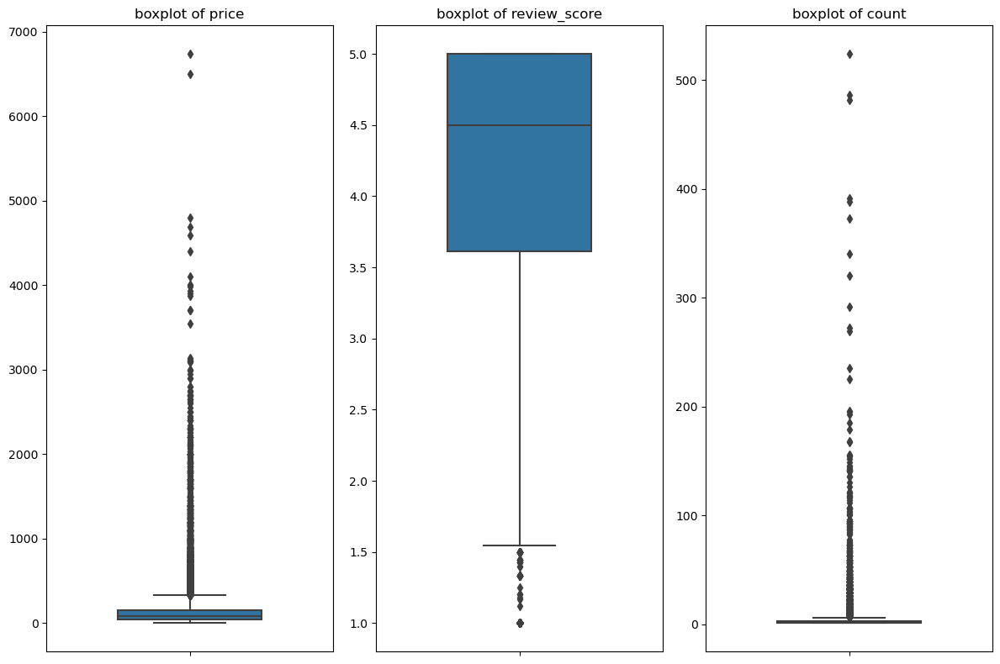

In [19]:
plt.figure(figsize=(12,8))

for i in list(z.columns):
    plt.subplot(1,3,list(z.columns).index(i)+1)
    sns.boxplot(data=z,y=i,width = 0.5)
    plt.title(f'boxplot of {i}')
    plt.ylabel('')
plt.tight_layout()
plt.show()

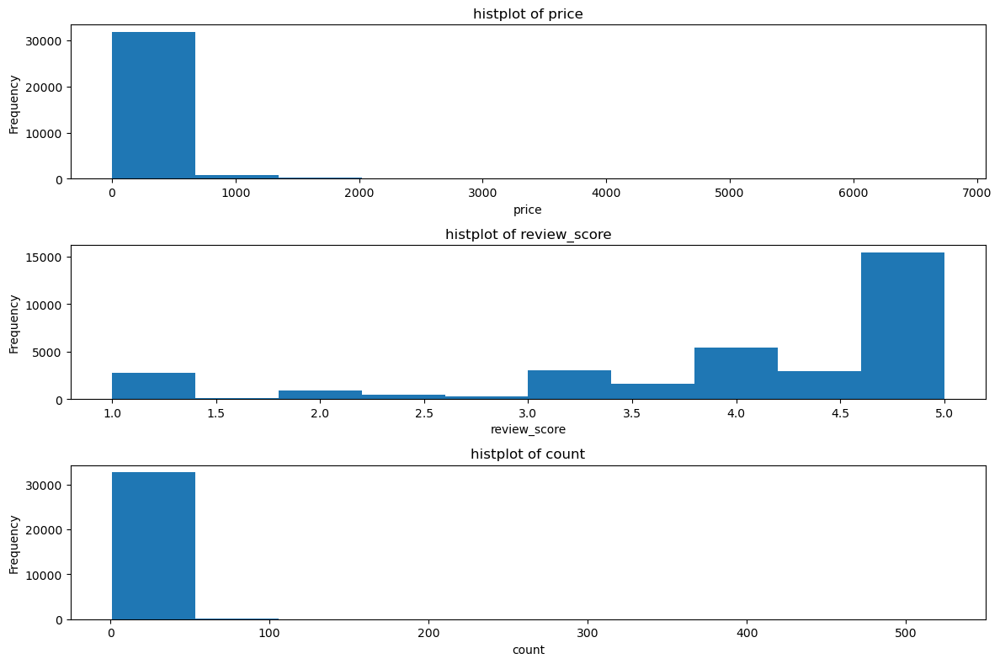

In [20]:
plt.figure(figsize=(12,8))

for i in list(z.columns):
    plt.subplot(3,1,list(z.columns).index(i)+1)
    plt.hist(z[i])
    plt.title(f'histplot of {i}')
    plt.ylabel('Frequency')
    plt.xlabel(f'{i}')
plt.tight_layout()
plt.show()

<Axes: >

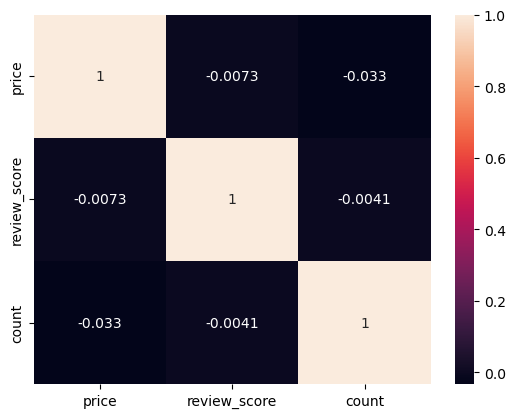

In [21]:
sns.heatmap(z.corr(), annot= True)

In [22]:
z['review_score']=(z['review_score'].round(0)).astype(int)
encoded_class = { 1 : 'Not Satisfied',
                  2 : 'Not Satisfied', 
                  3 : 'Not Bad', 
                  4 : 'Good', 
                  5 : 'Satisfied'}

z['review_categ'] = z['review_score'].map(encoded_class)
z
# X = df.drop('review_score', axis=1)
# y = df['review_score']

,price,review_score,count,review_categ
product_id,,,,
00066f42aeeb9f3007548bb9d3f33c38,101.65,5,1,Satisfied
00088930e925c41fd95ebfe695fd2655,129.90,4,1,Good
0009406fd7479715e4bef61dd91f2462,229.00,1,1,Not Satisfied
000b8f95fcb9e0096488278317764d19,58.90,5,2,Satisfied
000d9be29b5207b54e86aa1b1ac54872,199.00,5,1,Satisfied
...,...,...,...,...
fff6177642830a9a94a0f2cba5e476d1,114.99,4,2,Good
fff81cc3158d2725c0655ab9ba0f712c,90.00,4,1,Good
fff9553ac224cec9d15d49f5a263411f,32.00,5,1,Satisfied


In [23]:
z['count_categ']  = pd.cut(z['count'],bins=4,duplicates='drop',labels=[1,2,3,4])
z['price_categ'] = pd.qcut(z['price'],q=4,labels=[1, 2, 3, 4])

def Advertisement(c,p,r):
    if c ==1 and p in [3,2,1]:
        add= "Need Advertisement"
           
def discount(c,p,r):
    c=int(c)
    p=int(p)
    r=int(r)
    if(p== 4):
        if r in [5,4]:
            k=lambda x: 5 if x>=3 else 10
            dis = k(c)
        elif r == 3:
            k=lambda x: 10 if x>=3 else 20
            dis = k(c)
        else:
            k=lambda x: 15 if x>=3 else 25
            dis = k(c)
    else:
        if ( (r in [5,4,3]) and (c in [3,2,1])):
            k=lambda x: 10 if (x in [3,2]) else 20
            dis = k(c)
        elif ( (r in [5,4,3]) and c == 4):
            k=lambda x: 0 if (x in [5,4]) else 5
            dis = k(r)
        else:
            if p ==3:
                if c == 4:
                    dis = 25
                else:
                    k=lambda x: 30 if (x in [3,2]) else 40   
                    dis = k(c)      
            else:
                if c==4:
                    dis = 30
                else:
                    k=lambda x: 2 if (x in [3,2]) else 50 
                    dis = k(c)
    return dis
                    
z['Discount'] = z.apply(lambda x: discount(x['count_categ'],x['price_categ'],x['review_score']), axis =1)                    

<class 'pandas.core.frame.DataFrame'>
Index: 32789 entries, 00066f42aeeb9f3007548bb9d3f33c38 to fffe9eeff12fcbd74a2f2b007dde0c58
Data columns (total 7 columns):
 #   Column        Non-Null Count  Dtype   
---  ------        --------------  -----   
 0   price         32789 non-null  float64 
 1   review_score  32789 non-null  int32   
 2   count         32789 non-null  int64   
 3   review_categ  32789 non-null  object  
 4   count_categ   32789 non-null  category
 5   price_categ   32789 non-null  category
 6   Discount      32789 non-null  int64   
dtypes: category(2), float64(1), int32(1), int64(2), object(1)
memory usage: 1.4+ MB


<Axes: >

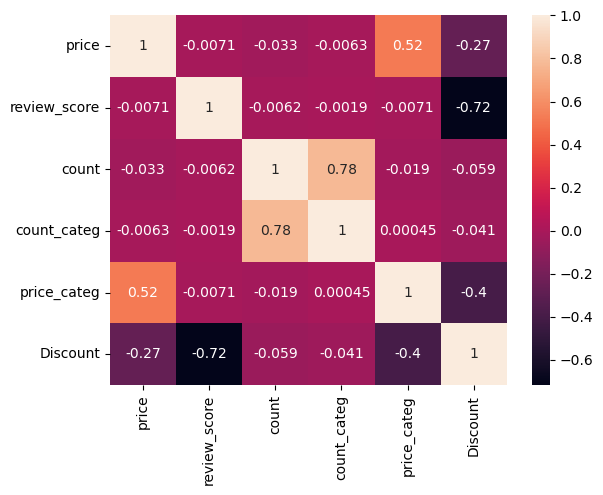

In [24]:
z.info()
z['count_categ']=z['count_categ'].astype(int)
z['price_categ']=z['price_categ'].astype(int)
sns.heatmap(z.corr(), annot= True)

<Axes: >

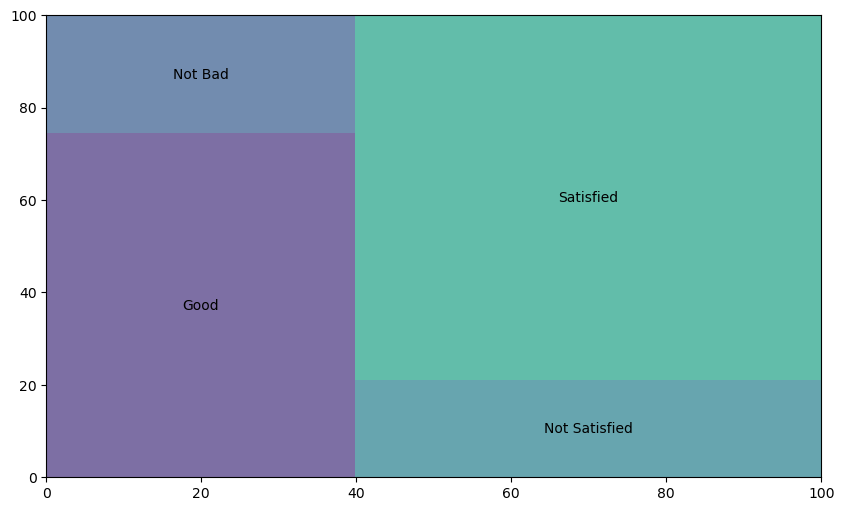

In [25]:
z.max()
z_descriptive = z.groupby('review_categ').describe()
plt.figure(figsize=(10, 6))
squarify.plot(
    sizes=z_descriptive['Discount']['count'],
    label=z_descriptive['Discount'].index,
    color=sns.color_palette(palette='viridis'),
    alpha=0.7
)


In [26]:
X = z[['count_categ','review_score','price_categ']]
y = z['review_score']

le = LabelEncoder()
X['review_score'] = le.fit_transform(X['review_score'])
y = le.transform(y)
cols = X.columns
ms = MinMaxScaler()
X = ms.fit_transform(X)
X = pd.DataFrame(X, columns=cols)
kmeans = KMeans(n_clusters=8, random_state=0) 
# x=X.drop(7)
kmeans.fit(X)

KMeans(random_state=0)

Cluster Centers:
    count_categ  review_score   price_categ
0  4.228388e-18      1.000000  6.666667e-01
1  2.575196e-04      0.903160  5.162537e-15
2  4.119968e-18      0.281192  1.645828e-01
3  5.520592e-04      0.685575  1.000000e+00
4  1.074402e-03      0.902458  3.333333e-01
5  2.168404e-18      0.080336  8.455550e-01
6  4.228388e-18      1.000000  1.000000e+00
7  2.073460e-03      0.689425  6.666667e-01

Number of data points in each cluster:
1    6472
4    6205
6    4029
0    3788
2    3759
7    3376
3    3019
5    2141
Name: lab, dtype: int64


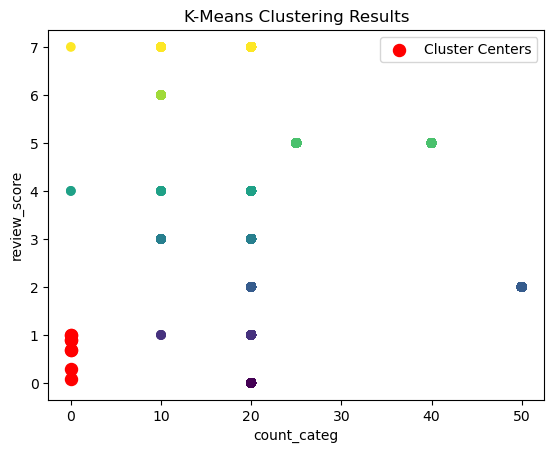

In [27]:

cls = pd.DataFrame(columns=['dis','lab'])
cls['dis']=z['Discount']
cls['lab']=kmeans.labels_ 
cls.head()

cluster_centers = pd.DataFrame(kmeans.cluster_centers_, columns=cols)
print("Cluster Centers:")
print(cluster_centers)


cluster_counts = cls['lab'].value_counts()
print("\nNumber of data points in each cluster:")
print(cluster_counts)



plt.scatter(cls['dis'], cls['lab'], c=cls['lab'], cmap='viridis')
plt.scatter(kmeans.cluster_centers_[:, 0], kmeans.cluster_centers_[:, 1], s=300, c='red', marker='.', label='Cluster Centers')
plt.xlabel(cols[0])
plt.ylabel(cols[1])
plt.title('K-Means Clustering Results')
plt.legend()
plt.show()


<Axes: >

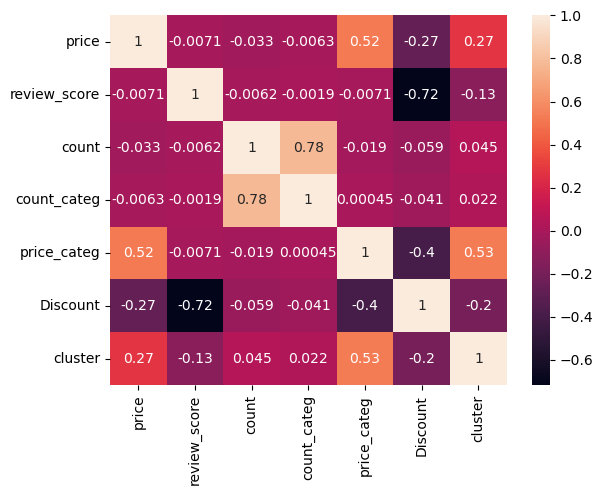

In [28]:
z['cluster']=cls['lab']
sns.heatmap(z.corr(), annot= True)

<Axes: >

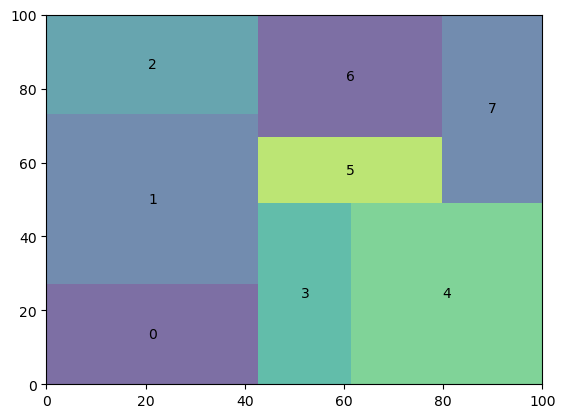

In [29]:
z_descriptive = z.groupby('cluster').describe()
squarify.plot(
    sizes=z_descriptive['count']['count'],
    label=z_descriptive['count'].index,
    color=sns.color_palette(palette='viridis'),
    alpha=0.7
)

Insights 

In [30]:
for i in range(0,8):
    print('Cluster',i,'Discount,count,price,review')
    print(z[z['cluster']==i]['Discount'].unique(),z[z['cluster']==i]['count_categ'].unique(),z[z['cluster']==i]['price_categ'].unique(),z[z['cluster']==i]['review_categ'].unique())


Cluster 0 Discount,count,price,review
[20] [1] [3] ['Satisfied']
Cluster 1 Discount,count,price,review
[20 10] [1 2 3] [1] ['Good' 'Satisfied']
Cluster 2 Discount,count,price,review
[50 20] [1] [2 1] ['Not Satisfied' 'Not Bad']
Cluster 3 Discount,count,price,review
[20 10] [1 2] [4] ['Not Bad' 'Good']
Cluster 4 Discount,count,price,review
[20 10  0] [1 2 3 4] [2] ['Satisfied' 'Good']
Cluster 5 Discount,count,price,review
[25 40] [1] [4 3] ['Not Satisfied']
Cluster 6 Discount,count,price,review
[10] [1] [4] ['Satisfied']
Cluster 7 Discount,count,price,review
[20 10  0] [1 2 3 4] [3] ['Good' 'Not Bad']


    .#0  Need add
    .#1  Need add
    .#2  quality improve
    .#3  reasonable 
    .#4  reasonable
    .#5  not reasonable
    .#6  need advertisement 
    .#7  reasonable

Prediction are done based on Count, Price and Review

0. Need Advertisement - As the review is 'Satisfied', price is 'Average' and count is 'Less' . The product need further advertisement to increase the sale.

1. Need Advertisement - As the review is 'Satisfied', price is 'Low' and count is 'Average' . The product need further advertisement to increase the sale. Later based on the sales increase, can increase the price of the product also.

2. Quality Improve - As the review is 'Not Satisfied' & 'Not Bad' , price is 'Low' and count is 'Low' . The product needs to improvise in Quality.

3. Reasonable - As the review is 'Satisfied' & 'Good' , price is 'More than average' and count is 'Low' . The product is reasonable since review is good.

4. Reasonable - As the review is 'Satisfied' & 'Good' , price is 'Less' and count is 'More than average' . The product is reasonable since review is good.    

5. Not Reasonable - As the review is 'Not Satisfied', price is 'More than average' and count is 'Less' . The product is not reasonable since review is bad and price is more than average.

6. Need Advertisement - As the review is 'Satisfied', price is 'More than average' and count is 'Less' . The product need further advertisement to increase the sale. 

7. Reasonable - As the review is 'Not Bad' & 'Good' , price is 'Average' and count is 'More than average' . The product is reasonable since review is good.

In [31]:
encoded_class = { 
0 : 'Need_advertisement',
1 : 'Need_advertisement',
2 : 'Quality_Improvment',
3 : 'Reasonable' ,
4 : 'Reasonable',
5 : 'Not_Reasonable',
6 : 'Need_advertisement', 
7 : 'Reasonable'
                
}

z['Action_Need'] = z['cluster'].map(encoded_class)
z

,price,review_score,count,review_categ,count_categ,price_categ,Discount,cluster,Action_Need
product_id,,,,,,,,,
00066f42aeeb9f3007548bb9d3f33c38,101.65,5,1,Satisfied,1,3,20,0,Need_advertisement
00088930e925c41fd95ebfe695fd2655,129.90,4,1,Good,1,3,20,7,Reasonable
0009406fd7479715e4bef61dd91f2462,229.00,1,1,Not Satisfied,1,4,25,5,Not_Reasonable
000b8f95fcb9e0096488278317764d19,58.90,5,2,Satisfied,1,2,20,4,Reasonable
000d9be29b5207b54e86aa1b1ac54872,199.00,5,1,Satisfied,1,4,10,6,Need_advertisement
...,...,...,...,...,...,...,...,...,...
fff6177642830a9a94a0f2cba5e476d1,114.99,4,2,Good,1,3,20,7,Reasonable
fff81cc3158d2725c0655ab9ba0f712c,90.00,4,1,Good,1,3,20,7,Reasonable
fff9553ac224cec9d15d49f5a263411f,32.00,5,1,Satisfied,1,1,20,1,Need_advertisement


Predictive best suitable discount based on count , review_score,price

In [32]:
X = z[['count','review_score','price']]
y = z['Discount']


X_train, X_test, y_train, y_test = train_test_split(X, y,test_size=0.2, random_state=42)

model = LogisticRegression(multi_class='multinomial',solver='lbfgs',max_iter=1000)
model.fit(X_train, y_train)


y_pred = model.predict(X_test)
y_pred1 = model.predict(X_train)


accuracy_Testing = accuracy_score(y_test, y_pred)
accuracy_Trainging = accuracy_score(y_train, y_pred1)
confusion = confusion_matrix(y_test, y_pred)
classification_rep = classification_report(y_test, y_pred,zero_division=1)

print("Testing Accuracy:", accuracy_Testing)
print("Training Accuracy:", accuracy_Trainging)
print("\nConfusion Matrix:")
print(confusion)
print("\nClassification Report:")
print(classification_rep)

Testing Accuracy: 0.9431229033241842
Training Accuracy: 0.944760016774046

Confusion Matrix:
[[   0    1    0    0    0    0]
 [   0  980  275    0    0    0]
 [   0   63 4409    0    0    0]
 [   0    0    0  206   16    0]
 [   0    0    0    0  183   10]
 [   0    0    0    0    8  407]]

Classification Report:
              precision    recall  f1-score   support

           0       1.00      0.00      0.00         1
          10       0.94      0.78      0.85      1255
          20       0.94      0.99      0.96      4472
          25       1.00      0.93      0.96       222
          40       0.88      0.95      0.91       193
          50       0.98      0.98      0.98       415

    accuracy                           0.94      6558
   macro avg       0.96      0.77      0.78      6558
weighted avg       0.94      0.94      0.94      6558



Predictive best both suitable discount and Action needed based on count , review_score,price

In [33]:
y = z[['Discount','cluster']]

X_train, X_test, y_train, y_test = train_test_split(X, y,test_size=0.2, random_state=42)

# Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Create a Random Forest regressor
base_regressor = RandomForestRegressor(n_estimators=100, random_state=0)

# Wrap the regressor with MultiOutputRegressor
multioutput_regressor = MultiOutputRegressor(base_regressor)

# Train the model
multioutput_regressor.fit(X_train, y_train)

# Make predictions on the test set
y_pred = multioutput_regressor.predict(X_test)

# Evaluate the model
mse = mean_squared_error(y_test, y_pred)
print("Mean Squared Error:", mse)


Mean Squared Error: 0.0002246264104910034


In [34]:
multioutput_regressor.predict([['10','4','300']])

array([[10.,  3.]])

Payment preference by cutomer

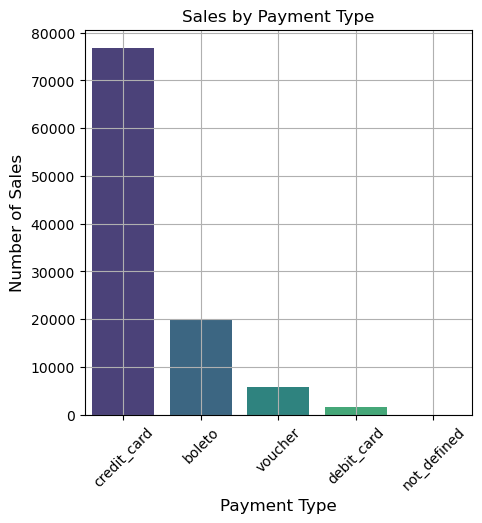

In [35]:
# pd.merge(df_payments,df)
payment_type_counts = df_payments['payment_type'].value_counts()
plt.figure(figsize=(5, 5))
sns.barplot(x=payment_type_counts.index, y=payment_type_counts.values, palette='viridis')
plt.title('Sales by Payment Type')
plt.ylabel('Number of Sales', fontsize=12)
plt.xlabel('Payment Type', fontsize=12)
plt.grid()
plt.xticks(rotation=45) 
plt.show()

Classifing customers

In [36]:
customer_class=pd.DataFrame(columns=['Inactive_days','price','frequency'])
cur_time = pd.to_datetime('2019-01-01 15:18:12')

customer_class['Inactive_days'] = (cur_time - df.groupby('customer_id')['order_purchase_timestamp'].max()).dt.days
customer_class['price']= df.groupby('customer_id')['price'].mean()
customer_class['frequency']=df.groupby('customer_id')['price'].count()
customer_class

customer_class['Inactive_days_level']  = pd.qcut(customer_class['Inactive_days'], q=4,labels=[4,3,2,1])
customer_class['price_level'] = pd.qcut(customer_class['price'],q=4,labels=[1, 2, 3, 4])
customer_class['frequency_level'] = pd.cut(customer_class['frequency'],bins=4,duplicates='drop',labels=[1, 2, 3, 4])
# 100 - 4 75 -3 50 -2 25-1 -frequency_level
# 100 - 1 75 -2 50 -3 25-4 - inactive


def segment(i,p,f):
    if p==4:
        return 'GOLD'
    elif (p in [3,2,1]):
        if(f==1 and i==4):
            return 'FRESHER'
        elif((f in [4,3]) and (i in [4,3,2,1])):
            return 'LOYAL'
        elif((f in [2,1]) and (i in [2,3,4])):
            return 'AVERAGE'
        elif((f in [1,2]) and (i in [1])):
            return 'GONERS'
        
customer_class['Class'] = customer_class.apply(lambda x:
                        segment(x['Inactive_days_level'],x['price_level'],x['frequency_level'])
                        ,axis=1)
customer_class.info()

customer_class['Inactive_days_level'] = customer_class['Inactive_days_level'].astype(int)
customer_class['price_level'] = customer_class['Inactive_days_level'].astype(int)
customer_class['frequency_level'] = customer_class['Inactive_days_level'].astype(int)


customer_class.info()


<class 'pandas.core.frame.DataFrame'>
Index: 98630 entries, 00012a2ce6f8dcda20d059ce98491703 to ffffa3172527f765de70084a7e53aae8
Data columns (total 7 columns):
 #   Column               Non-Null Count  Dtype   
---  ------               --------------  -----   
 0   Inactive_days        98630 non-null  int64   
 1   price                98630 non-null  float64 
 2   frequency            98630 non-null  int64   
 3   Inactive_days_level  98630 non-null  category
 4   price_level          98630 non-null  category
 5   frequency_level      98630 non-null  category
 6   Class                98630 non-null  object  
dtypes: category(3), float64(1), int64(2), object(1)
memory usage: 4.0+ MB
<class 'pandas.core.frame.DataFrame'>
Index: 98630 entries, 00012a2ce6f8dcda20d059ce98491703 to ffffa3172527f765de70084a7e53aae8
Data columns (total 7 columns):
 #   Column               Non-Null Count  Dtype  
---  ------               --------------  -----  
 0   Inactive_days        98630 non-null  in

Cluster Centers:
    count_categ  review_score   price_categ
0  4.228388e-18      1.000000  6.666667e-01
1  2.575196e-04      0.903160  5.162537e-15
2  4.119968e-18      0.281192  1.645828e-01
3  5.520592e-04      0.685575  1.000000e+00
4  1.074402e-03      0.902458  3.333333e-01
5  2.168404e-18      0.080336  8.455550e-01
6  4.228388e-18      1.000000  1.000000e+00
7  2.073460e-03      0.689425  6.666667e-01

Number of data points in each cluster:
1    34862
3    31820
2    22150
0     9798
Name: lab, dtype: int64


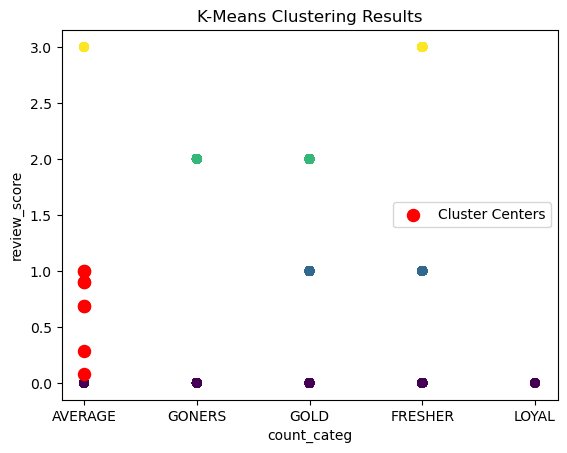

In [37]:
skewed_preprocess = Pipeline([
    ('binning',KBinsDiscretizer(n_bins=30,encode='ordinal')),
    ('scaling',RobustScaler(quantile_range=(0,100)))
])

transform = ColumnTransformer([
    ('skewed',skewed_preprocess,['Inactive_days_level','price','frequency']),
],remainder='passthrough')

transform_val = transform.fit_transform(customer_class[['Inactive_days_level','price','frequency']])

transformed_rfm = pd.DataFrame(data={
    'Inactive_days_level':transform_val[:,0],
    'price':transform_val[:,1],
    'frequency':transform_val[:,2]
    
})

transformed_rfm = transformed_rfm.astype(float)
cluster = KMeans(n_clusters=4,random_state=1995)
cluster.fit(transformed_rfm)


df_clust = pd.DataFrame(columns=['cls','lab'])
df_clust['cls']=customer_class['Class']
df_clust['lab']= cluster.labels_ 
df_clust.head()

cluster_centers = pd.DataFrame(kmeans.cluster_centers_, columns=cols)
print("Cluster Centers:")
print(cluster_centers)

# Count the number of data points in each cluster
cluster_counts = df_clust['lab'].value_counts()
print("\nNumber of data points in each cluster:")
print(cluster_counts)

# Visualize the clusters (assuming 2D data for simplicity)

plt.scatter(df_clust['cls'], df_clust['lab'], c=df_clust['lab'], cmap='viridis')
plt.scatter(kmeans.cluster_centers_[:, 0], kmeans.cluster_centers_[:, 1], s=300, c='red', marker='.', label='Cluster Centers')
plt.xlabel(cols[0])
plt.ylabel(cols[1])
plt.title('K-Means Clustering Results')
plt.legend()
plt.show()


<Axes: >

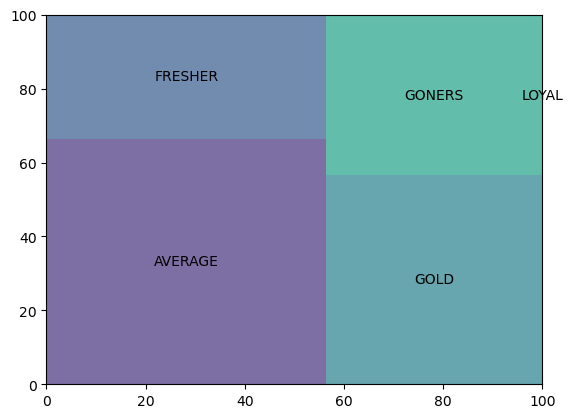

In [38]:
customer_class['cluster']=df_clust['cls']
C_descriptive = customer_class.groupby('cluster').describe()
squarify.plot(
    sizes=C_descriptive['Inactive_days']['count'],
    label=C_descriptive['Inactive_days'].index,
    color=sns.color_palette(palette='viridis'),
    alpha=0.7
)

Delivery analysis.

In [39]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 112609 entries, 0 to 112608
Data columns (total 23 columns):
 #   Column                         Non-Null Count   Dtype         
---  ------                         --------------   -----         
 0   order_id                       112609 non-null  object        
 1   order_item_id                  112609 non-null  int64         
 2   product_id                     112609 non-null  object        
 3   seller_id                      112609 non-null  object        
 4   shipping_limit_date            112609 non-null  datetime64[ns]
 5   price                          112609 non-null  float64       
 6   freight_value                  112609 non-null  float64       
 7   customer_id                    112609 non-null  object        
 8   order_status                   112609 non-null  object        
 9   order_purchase_timestamp       112609 non-null  datetime64[ns]
 10  order_approved_at              112609 non-null  datetime64[ns]
 11  

In [40]:
delivery_data=df[df['order_status']=='delivered'][['order_id','product_id','seller_id','customer_id','order_status','freight_value','order_purchase_timestamp','order_estimated_delivery_date','order_delivered_customer_date','product_weight_g','product_length_cm','product_width_cm']]

customers = delivery_data.groupby('customer_id').max()['order_id'].index
customers_loc = df_customers_geo[df_customers_geo['customer_id'].isin(customers)]
customers_loc.set_index('customer_id',inplace=True)
customer_lat =customers_loc['customer_geo_lat'].to_dict()
delivery_data['customer_geo_lat'] = delivery_data['customer_id'].map(customer_lat)
customer_lng =customers_loc['customer_geo_lng'].to_dict() 
delivery_data['customer_geo_lng'] = delivery_data['customer_id'].map(customer_lng)

sellers = delivery_data.groupby('seller_id').max()['order_id'].index
sellers_loc = df_sellers_geo[df_sellers_geo['seller_id'].isin(sellers)]
sellers_loc.set_index('seller_id',inplace=True)
seller_lat =sellers_loc['seller_geo_lat'].to_dict()
delivery_data['seller_geo_lat'] = delivery_data['seller_id'].map(seller_lat)
seller_lng =sellers_loc['seller_geo_lng'].to_dict() 
delivery_data['seller_geo_lng'] = delivery_data['seller_id'].map(seller_lng)
delivery_data.dropna(inplace=True) 


In [42]:
from math import radians, cos, sin, asin, sqrt,ceil,floor


def distance(lat1,lat2,lon1,lon2):
    dlon = lon2 - lon1 
    dlat = lat2 - lat1
    a = sin(dlat / 2)**2 + cos(lat1) * cos(lat2) * sin(dlon / 2)**2 
    c = 2 * asin(sqrt(a)) 
    r = 6371
    return (c * r)

delivery_data['delivery_distance'] = delivery_data.apply(lambda x: distance(x['customer_geo_lat'],x['seller_geo_lat'],x['customer_geo_lng'],x['seller_geo_lng']),axis=1)
delivery_data['estimation_diff'] = delivery_data.apply(lambda x: ((x['order_delivered_customer_date'] - x['order_estimated_delivery_date'])/np.timedelta64(1, 'D')) , axis=1)
delivery_data['estimation_diff'] = delivery_data.apply(lambda x: floor(x['estimation_diff']) if x['estimation_diff'] <0 else ceil(x['estimation_diff']), axis=1)
delivery_data['late_delivery'] = delivery_data.apply(lambda x: 1 if x['estimation_diff']<0 else 0  ,axis =1)
delivery_data['delivery_time'] = delivery_data.apply(lambda x: ceil((x['order_delivered_customer_date'] - x['order_purchase_timestamp'])/np.timedelta64(1, 'D')) , axis=1)


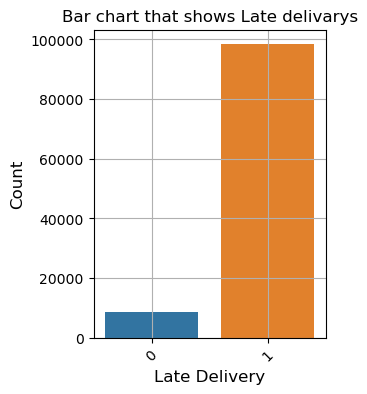

In [47]:
plt.figure(figsize=(3, 4))
data = delivery_data['late_delivery'].value_counts()
sns.barplot(x=data.index, y=data.values)
plt.title('Bar chart that shows Late delivarys')
plt.ylabel('Count', fontsize=12)
plt.xlabel('Late Delivery', fontsize=12)
plt.grid()
plt.xticks(rotation=45) 
plt.show()

<Axes: >

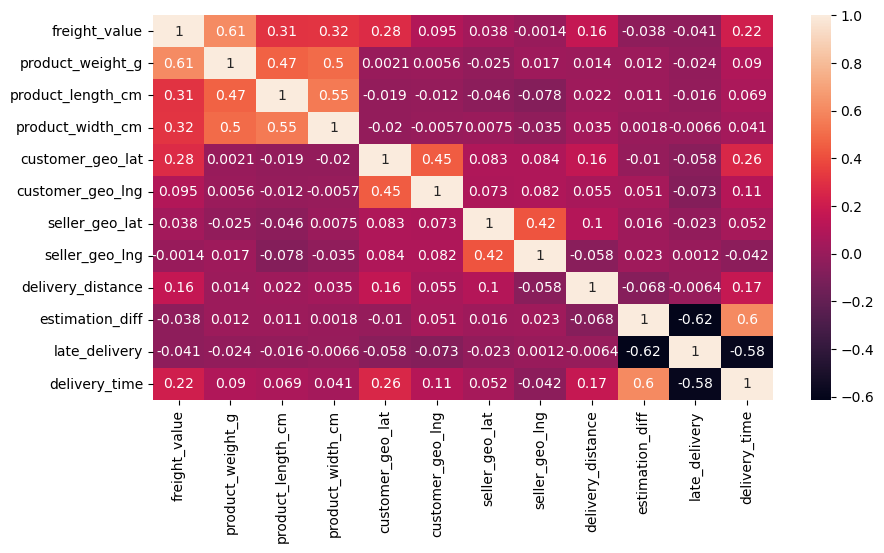

In [48]:
plt.figure(figsize=(10, 5))
sns.heatmap(delivery_data.corr(), annot= True) #delivery_data

In [50]:
skewed_preprocess = Pipeline([
    ('binning',KBinsDiscretizer(n_bins=30,encode='ordinal')),
    ('scaling',RobustScaler(quantile_range=(0,100)))
])

tra_X = ColumnTransformer([
    ('skewed',skewed_preprocess,['freight_value','product_weight_g','product_length_cm','product_width_cm','delivery_distance']),
],remainder='passthrough')

transform_val = tra_X.fit_transform(delivery_data[['freight_value','product_weight_g','product_length_cm','product_width_cm','delivery_distance']])
    
y = pd.cut(delivery_data['estimation_diff'],bins=6,duplicates='drop',labels=[1,2,3,4,5,6])

X = pd.DataFrame(data={
    'freight_value':transform_val[:,0],
    'product_weight_g':transform_val[:,1],
    'product_length_cm':transform_val[:,2],
    'product_width_cm':transform_val[:,3],
    'delivery_distance':transform_val[:,4]
        
})


X_train, X_test, y_train, y_test = train_test_split(X, y,test_size=0.2, random_state=42)

model = LogisticRegression(multi_class='multinomial',solver='lbfgs',max_iter=1000)
model.fit(X_train, y_train)


y_pred = model.predict(X_test)
y_pred1 = model.predict(X_train)


accuracy_Testing = accuracy_score(y_test, y_pred)
accuracy_Trainging = accuracy_score(y_train, y_pred1)
confusion = confusion_matrix(y_test, y_pred)
classification_rep = classification_report(y_test, y_pred,zero_division=1)

print("Testing Accuracy:", accuracy_Testing)
print("Training Accuracy:", accuracy_Trainging)
print("\nConfusion Matrix:")
print(confusion)
print("\nClassification Report:")
print(classification_rep)

Testing Accuracy: 0.9786098759653639
Training Accuracy: 0.977872430054178

Confusion Matrix:
[[    0   296     0     0     0]
 [    0 20908     0     0     0]
 [    0   151     0     0     0]
 [    0     7     0     0     0]
 [    0     3     0     0     0]]

Classification Report:
              precision    recall  f1-score   support

           2       1.00      0.00      0.00       296
           3       0.98      1.00      0.99     20908
           4       1.00      0.00      0.00       151
           5       1.00      0.00      0.00         7
           6       1.00      0.00      0.00         3

    accuracy                           0.98     21365
   macro avg       1.00      0.20      0.20     21365
weighted avg       0.98      0.98      0.97     21365



In [51]:
model.predict([[455,66,44,78,1000]])

array([4], dtype=int64)

Order density across the Brazil for customers and sellers: 

customers

In [52]:
sample_geo_data = df_customers_geo.sample(frac=0.05)
coords = sample_geo_data[['customer_geo_lat', 'customer_geo_lng']].values.tolist()
m = folium.Map(location=[-14.2350, -51.9253], zoom_start=4)
HeatMap(coords, radius=10).add_to(m)
m


sellers:

In [53]:
sample_geo_data = df_sellers_geo.sample(frac=0.05)
coords = sample_geo_data[['seller_geo_lat', 'seller_geo_lng']].values.tolist()
m = folium.Map(location=[-14.2350, -51.9253], zoom_start=4)
HeatMap(coords, radius=10).add_to(m)
m
